<a href="https://colab.research.google.com/github/Maytsukirp/ejemplo/blob/master/YOLOV5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

YOLOV5

In [ ]:
!git clone https://github.com/ultralytics/yolov5  # clone repo
!pip install -qr yolov5/requirements.txt  # install dependencies (ignore errors)
%cd yolov5

import torch
from IPython.display import Image, clear_output  # to display images
from utils.google_utils import gdrive_download  # to download models/datasets

clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Setup complete. Using torch 1.7.0+cu101 _CudaDeviceProperties(name='Tesla P100-PCIE-16GB', major=6, minor=0, total_memory=16280MB, multi_processor_count=56)


In [ ]:
# Export code snippet and paste here
%cd /content

!curl -L "https://app.roboflow.com/ds/hsUEjkaf4I?key=A6qSUrLFfW" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

/content
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   896  100   896    0     0    756      0  0:00:01  0:00:01 --:--:--   756
100 74.7M  100 74.7M    0     0  19.3M      0  0:00:03  0:00:03 --:--:-- 37.6M
Archive:  roboflow.zip
 extracting: README.roboflow.txt     
 extracting: data.yaml               
   creating: test/
   creating: test/images/
 extracting: test/images/c1anemia-160_jpg.rf.63d2935ff64d5ea35ab373e5e62da93f.jpg  
 extracting: test/images/c1anemia-198_jpg.rf.d046da1c05844ce2375a8a0b244b09f4.jpg  
 extracting: test/images/c1anemia-398_jpg.rf.3f753913e19b01b59246f48f04c6a479.jpg  
 extracting: test/images/c1anemia-410_jpg.rf.4715203c76661d1672f0e05f8207b927.jpg  
 extracting: test/images/c1anemia-421_jpg.rf.adc7b7d67c47825ae4f3ba8fa19c9e9b.jpg  
 extracting: test/images/c1anemia-454_jpg.rf.20102fe82255f14d53e9ded002ade673.jpg  
 extracting: test/images/c1

In [ ]:
# this is the YAML file Roboflow wrote for us that we're loading into this notebook with our data
%cat data.yaml

train: ../train/images
val: ../valid/images

nc: 2
names: ['Anemia', 'Sin anemia']

In [ ]:
import yaml
with open("data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [ ]:
#this is the model configuration we will use for our tutorial 
%cat /content/yolov5/models/yolov5s.yaml

# parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-

In [ ]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))


In [ ]:
%%writetemplate /content/yolov5/models/custom_yolov5s.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

In [ ]:
# train yolov5s on custom data for 100 epochs
# time its performance
%%time
%cd /content/yolov5/
!python train.py --img 416 --batch 8 --epochs 500 --data '../data.yaml' --cfg ./models/custom_yolov5s.yaml --weights '' --name yolov5s_results  --cache


/content/yolov5
Using torch 1.7.0+cu101 CUDA:0 (Tesla P100-PCIE-16GB, 16280MB)

Namespace(adam=False, batch_size=8, bucket='', cache_images=True, cfg='./models/custom_yolov5s.yaml', data='../data.yaml', device='', epochs=500, evolve=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[416, 416], local_rank=-1, log_imgs=10, logdir='runs/train', multi_scale=False, name='yolov5s_results', noautoanchor=False, nosave=False, notest=False, rect=False, resume=False, single_cls=False, sync_bn=False, total_batch_size=8, weights='', workers=8, world_size=1)
Start Tensorboard with "tensorboard --logdir runs/train", view at http://localhost:6006/
2020-11-12 04:00:17.373180: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
Install Weights & Biases for experiment logging via 'pip install wandb' (recommended)
Hyperparameters {'lr0': 0.01, 'lrf': 0.2, 'momentum': 0.937, 'weight_decay': 0.0005, 'warmup_epo

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs
%reload_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 2522), started 2:16:31 ago. (Use '!kill 2522' to kill it.)

<IPython.core.display.Javascript object>

TypeError: ignored

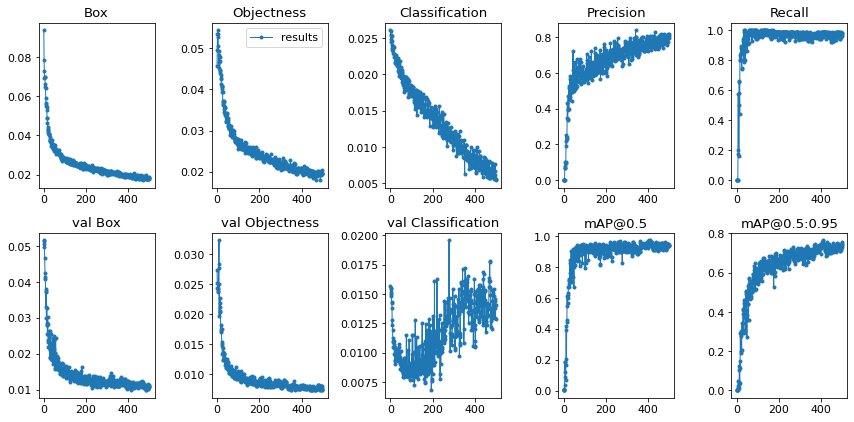

In [ ]:
# we can also output some older school graphs if the tensor board isn't working for whatever reason... 


#from utils.general import plot_results; plot_results()  # plot results.txt as results.png
#Image(filename='/content/yolov5/runs/exp0_yolov5s_results/results.png', width=1000)  # view results.png

from utils.general import plot_results 
plot_results(save_dir='/content/yolov5/runs/train/exp1_yolov5s_results')
#Image(filename='results.png', width=800)

Image(filename='/content/yolov5/runs/train/exp0_yolov5s_results/results.png', width=1000)  # view results.png

In [ ]:
# trained weights are saved by default in our weights folder
%ls runs/

detect/  train/


In [ ]:
%ls runs/train/exp0_yolov5s_results/weights

best.pt  last.pt


In [ ]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd /content/yolov5/
!python detect.py --weights runs/train/exp0_yolov5s_results/weights/best.pt --img 416 --conf 0.4 --source ../test/images


/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=416, iou_thres=0.45, name='', save_conf=False, save_dir='runs/detect', save_txt=False, source='../test/images', update=False, view_img=False, weights=['runs/train/exp0_yolov5s_results/weights/best.pt'])
Using torch 1.7.0+cu101 CUDA:0 (Tesla P100-PCIE-16GB, 16280MB)

Fusing layers... 
Model Summary: 140 layers, 7.24922e+06 parameters, 0 gradients
image 1/32 /content/test/images/c1anemia-160_jpg.rf.63d2935ff64d5ea35ab373e5e62da93f.jpg: 416x416 1 Sin anemias, Done. (0.015s)
image 2/32 /content/test/images/c1anemia-198_jpg.rf.d046da1c05844ce2375a8a0b244b09f4.jpg: 416x416 1 Sin anemias, Done. (0.015s)
image 3/32 /content/test/images/c1anemia-398_jpg.rf.3f753913e19b01b59246f48f04c6a479.jpg: 416x416 1 Anemias, Done. (0.014s)
image 4/32 /content/test/images/c1anemia-410_jpg.rf.4715203c76661d1672f0e05f8207b927.jpg: 416x416 1 Anemias, Done. (0.014s)
image 5/32 /content/test/images/c1ane

In [ ]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/inference/output/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

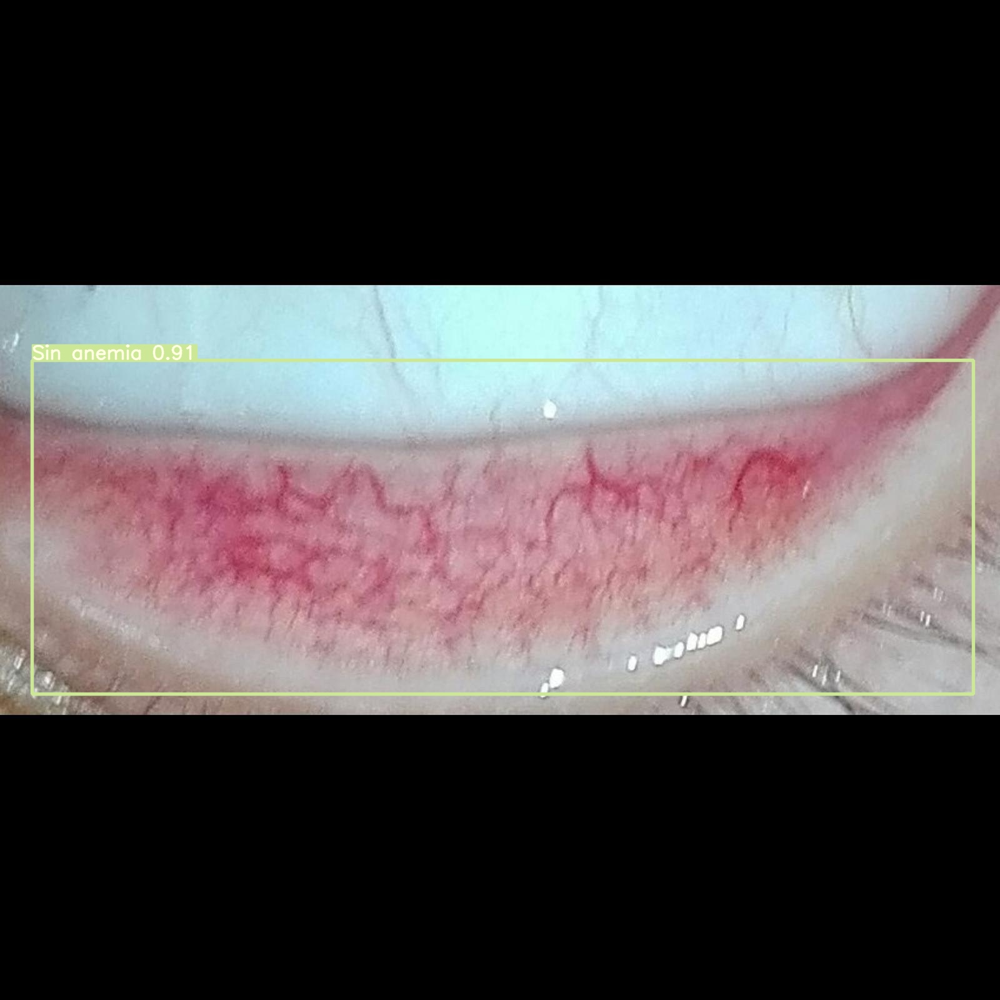

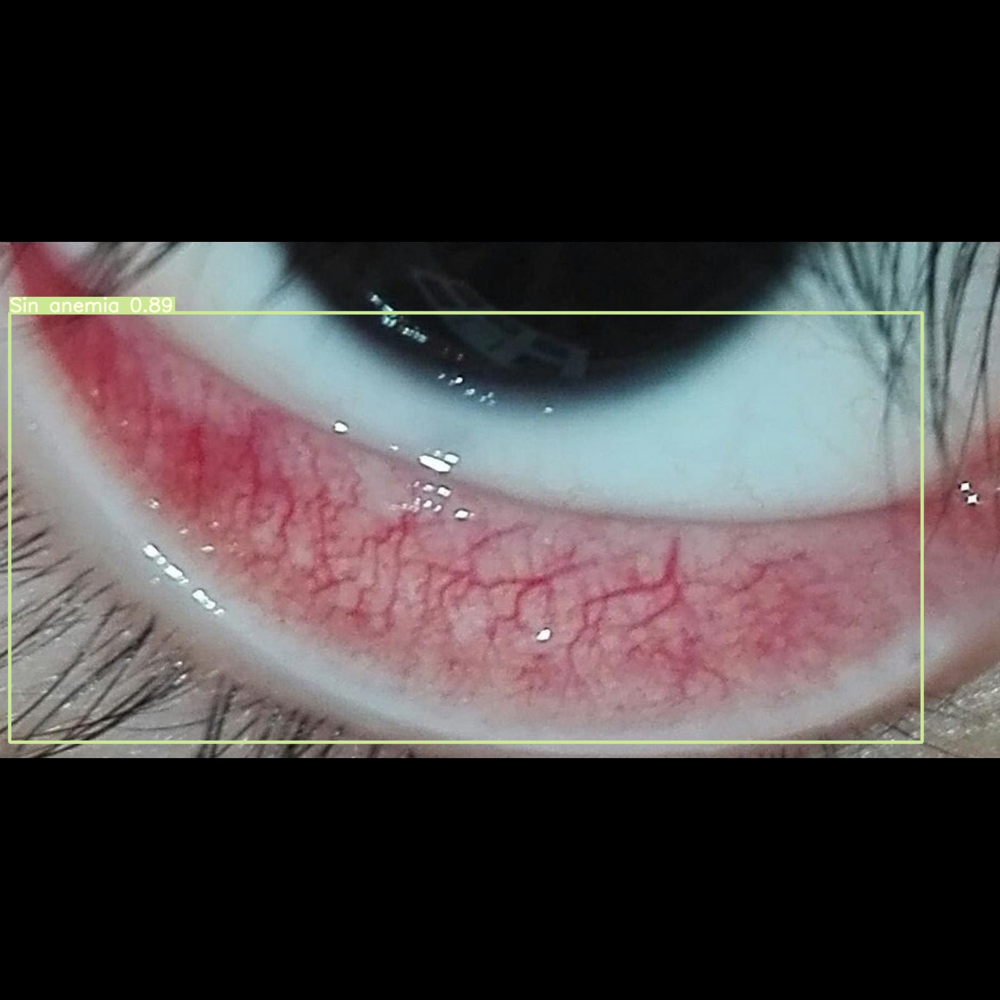

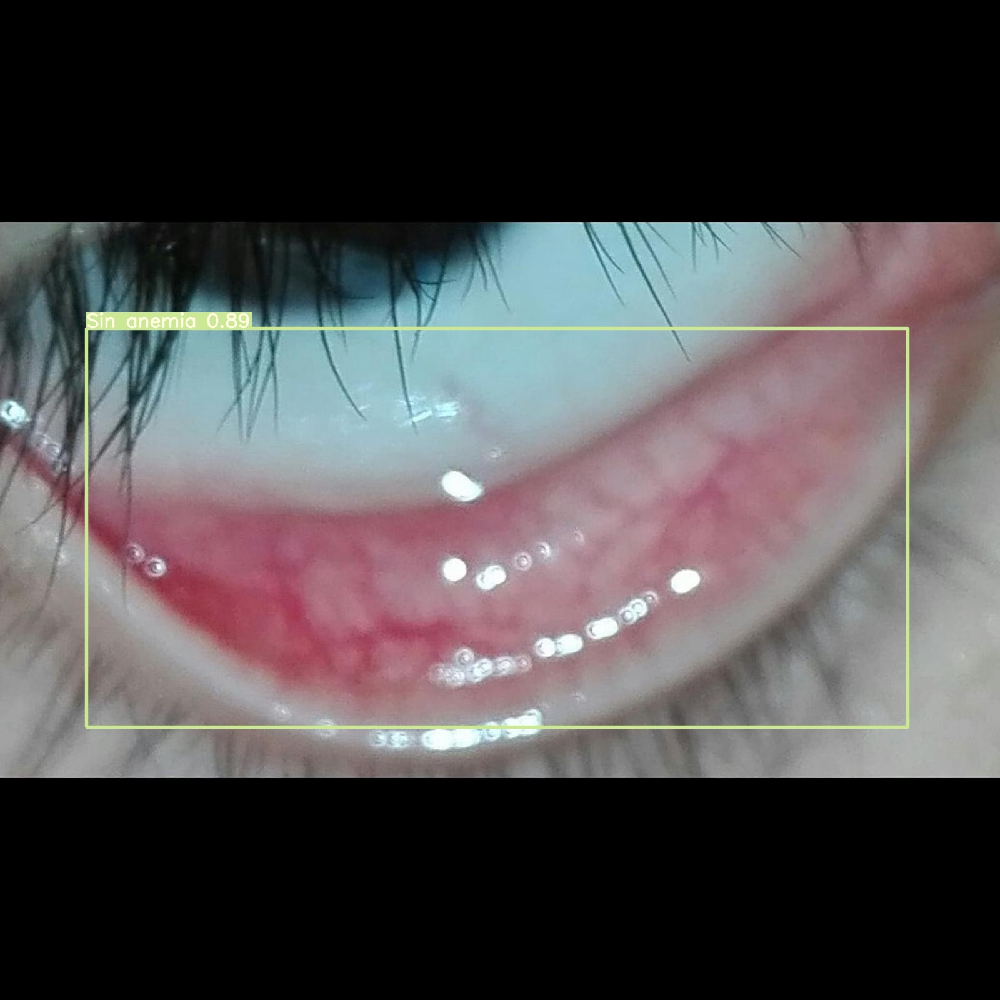

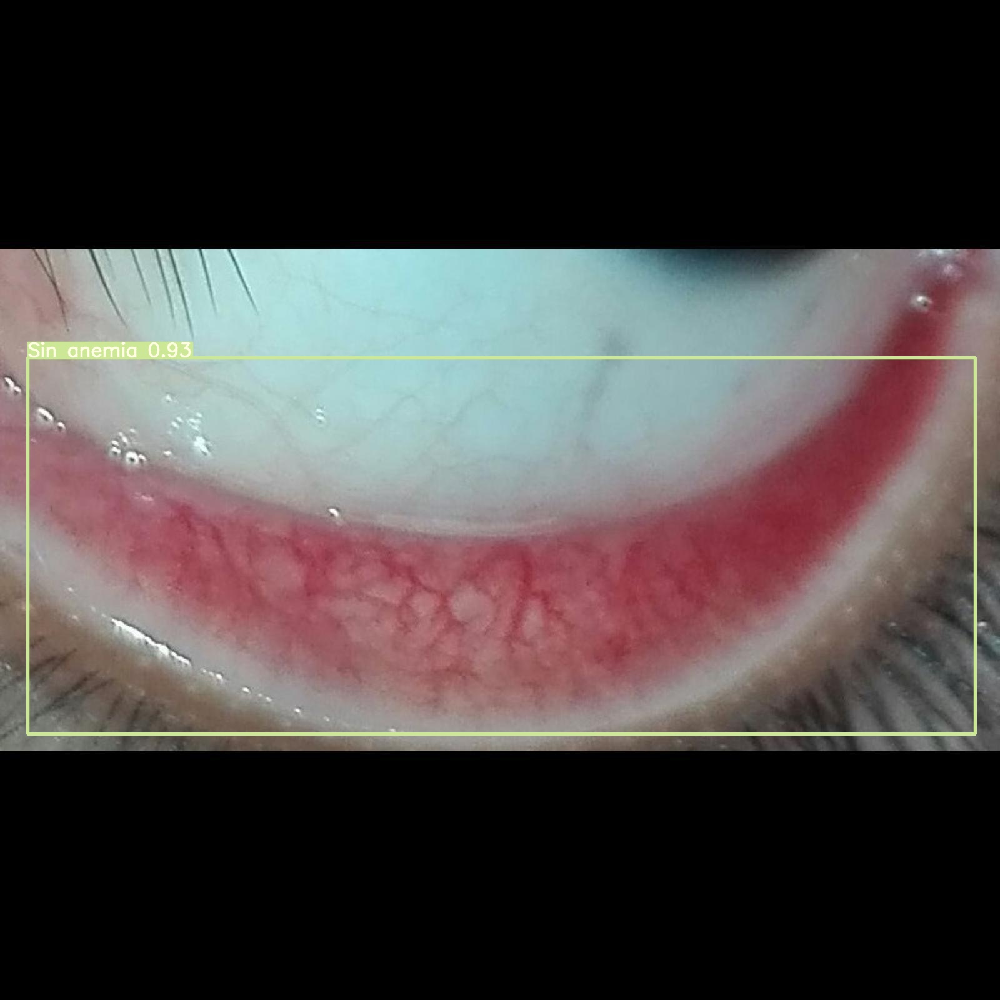

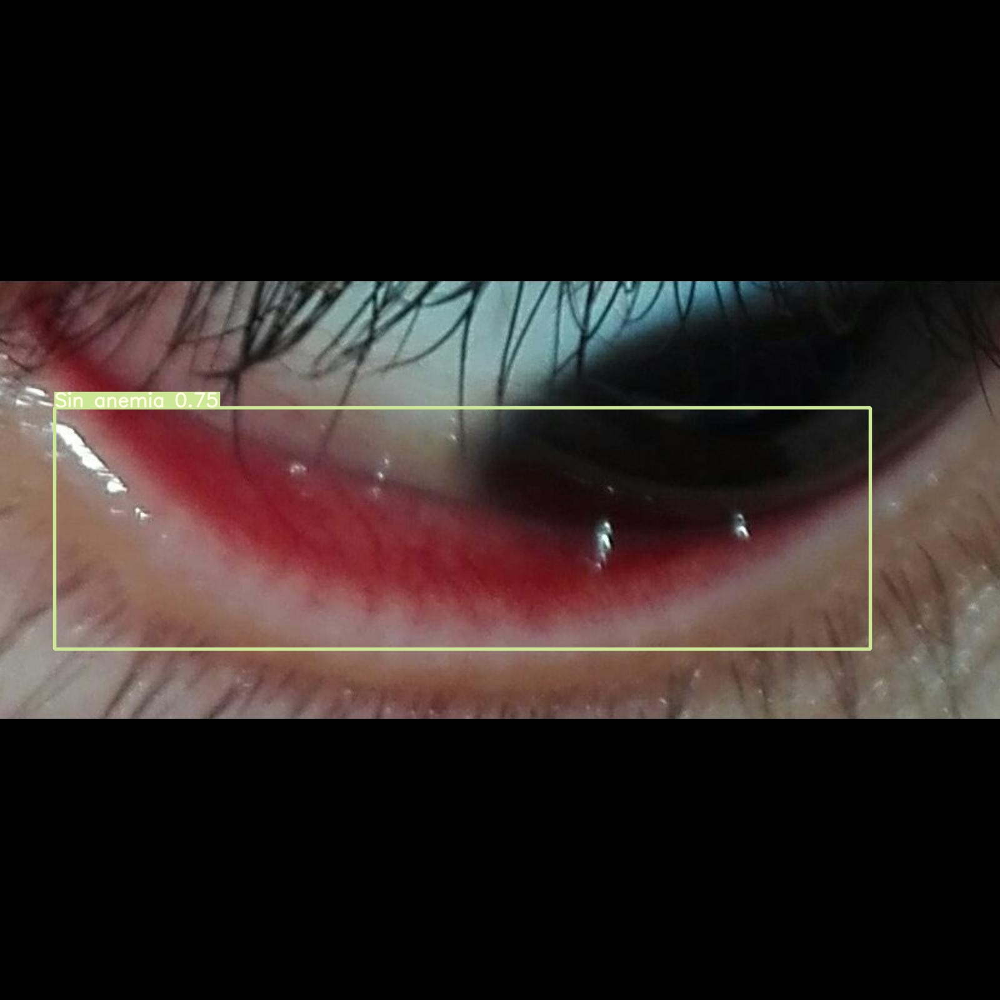

...

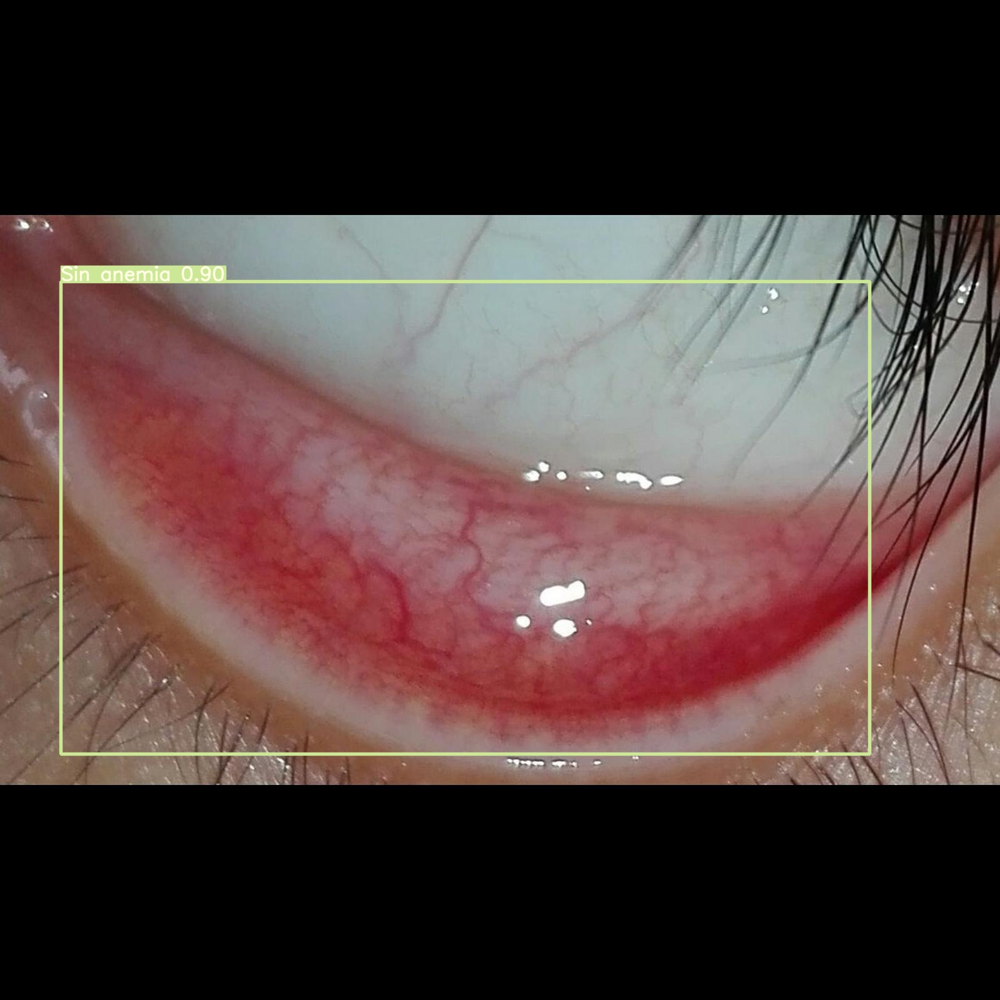

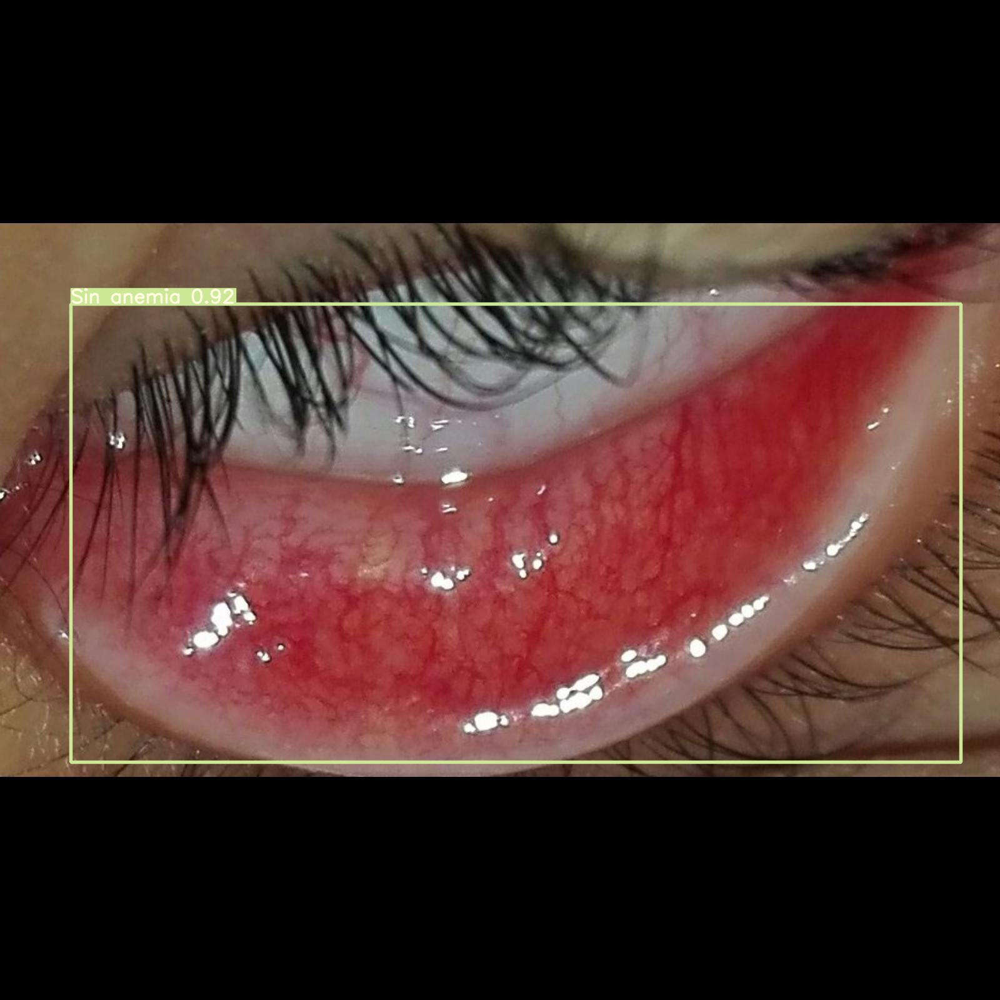

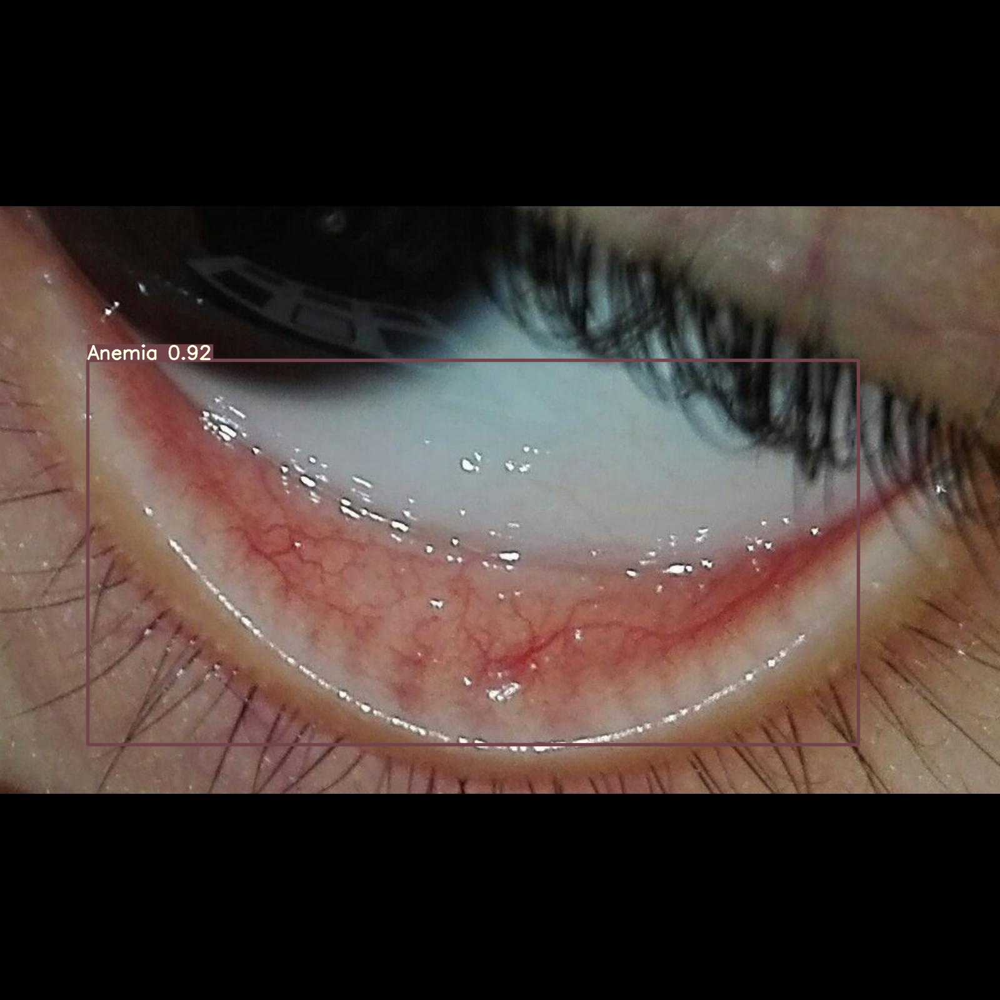

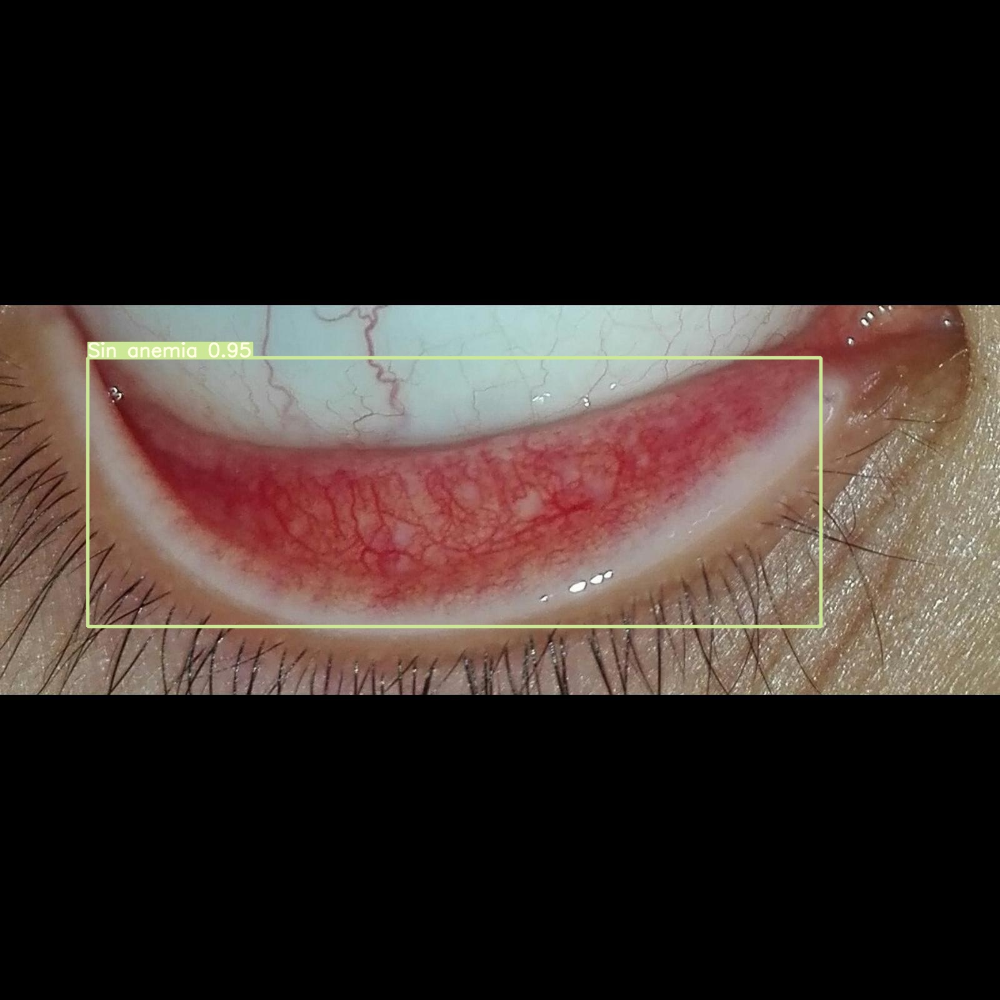

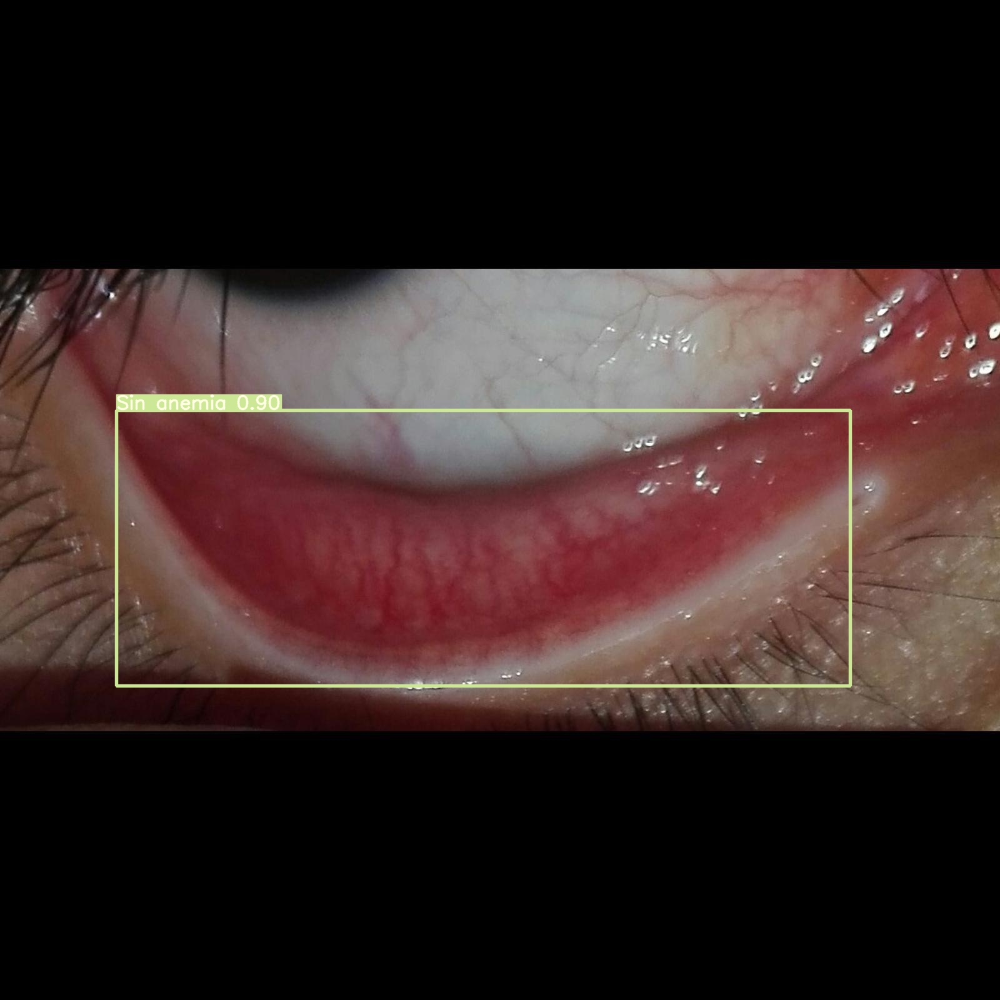

In [ ]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp2/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
%cp /content/yolov5/runs/train/exp0_yolov5s_results/weights/best.pt /content/gdrive/My\ Drive

In [ ]:
## Exportar modelo en pytorchscript

!PYTHONPATH="$PWD" && python models/export.py --weights ./weights/yolov5s.pt --img 640 --batch 1

Namespace(batch_size=1, img_size=[640, 640], weights='./weights/yolov5s.pt')
Fusing layers... 
Model Summary: 140 layers, 7.45958e+06 parameters, 0 gradients

Starting TorchScript export with torch 1.7.0+cu101...
/usr/local/lib/python3.6/dist-packages/torch/jit/_trace.py:940: TracerWarning: Encountering a list at the output of the tracer might cause the trace to be incorrect, this is only valid if the container structure does not change based on the module's inputs. Consider using a constant container instead (e.g. for `list`, use a `tuple` instead. for `dict`, use a `NamedTuple` instead). If you absolutely need this and know the side effects, pass strict=False to trace() to allow this behavior.
  _force_outplace,
TorchScript export success, saved as ./weights/yolov5s.torchscript.pt
ONNX export failure: No module named 'onnx'
CoreML export failure: No module named 'coremltools'

Export complete (4.60s). Visualize with https://github.com/lutzroeder/netron.


In [ ]:
import torch
from PIL import Image

# Model
model = torch.hub.load('ultralytics/yolov5', 'yolov5s', pretrained=True).fuse().eval()  # yolov5s.pt
model = model.autoshape()  # for autoshaping of PIL/cv2/np inputs and NMS

# Images
img1 = Image.open('/content/train/images/c1anemia-108_jpg.rf.ee7d9ffd59684d6440a37f7399591a91.jpg')
#img2 = Image.open('/content/train/images/c1anemia-124_jpg.rf.7343a7a7b88d4f0d4eea694b760383e4.jpg')
#imgs = [img1, img2]  # batched list of images

# Inference
prediction = model(img1, size=416)  # includes NMS//640

Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master

                 from  n    params  module                                  arguments                     
  0                -1  1      3520  models.common.Focus                     [3, 32, 3]                    
  1                -1  1     18560  models.common.Conv                      [32, 64, 3, 2]                
  2                -1  1     19904  models.common.BottleneckCSP             [64, 64, 1]                   
  3                -1  1     73984  models.common.Conv                      [64, 128, 3, 2]               
  4                -1  1    161152  models.common.BottleneckCSP             [128, 128, 3]                 
  5                -1  1    295424  models.common.Conv                      [128, 256, 3, 2]              
  6                -1  1    641792  models.common.BottleneckCSP             [256, 256, 3]                 
  7                -1  1   1180672  models.common.Conv                   

Fusing layers... 
Adding autoShape... 
